### Diffusion Models

#### References
- [MinDiffusion](https://github.com/cloneofsimo/minDiffusion/tree/master): Minimalistic implementation of diffusion models using Pytorch.
- [How Diffusion Models Work](https://www.coursera.org/projects/how-diffusion-models-work-project)
- [Annotated DDPM](https://sachinruk.github.io/blog/2023-04-18-ddpm.html#introduction)

In [3]:
import os

import matplotlib.pyplot as plt
import numpy as np
import torch
import torch.nn as nn
from IPython.display import HTML, display
from matplotlib.animation import FuncAnimation, PillowWriter
from torch.utils.data import DataLoader
from torchvision import transforms
from torchvision.transforms import functional as F
from torchvision.utils import make_grid, save_image
from tqdm.notebook import tqdm

%load_ext autoreload
%autoreload 2

In [4]:
import sys

sys.path.insert(0, "./notebooks/generative_models/diffusion_models")

In [ ]:
from ddpm import DDPM
from unet import NaiveUnet

In [5]:
plt.rcParams["savefig.bbox"] = "tight"


def show(imgs):
    if not isinstance(imgs, list):
        imgs = [imgs]
    fig, axs = plt.subplots(ncols=len(imgs), squeeze=False)
    for i, img in enumerate(imgs):
        img = img.detach()
        img = F.to_pil_image(img)
        axs[0, i].imshow(np.asarray(img))
        axs[0, i].set(xticklabels=[], yticklabels=[], xticks=[], yticks=[])

### Load the dataset

In [6]:
from torchvision.datasets import CIFAR10

In [7]:
tf = transforms.Compose(
    [transforms.ToTensor(), transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))]
)


dataset = CIFAR10(
    "./data",
    train=True,
    download=True,
    transform=tf,
)

dataloader = DataLoader(dataset, batch_size=256, shuffle=True, num_workers=32)

Files already downloaded and verified


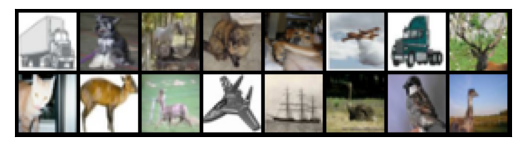

In [8]:
dataiter = iter(dataloader)
images, labels = next(dataiter)

show(make_grid(images[:16], normalize=True, value_range=(-1, 1)))

### Train Model

In [11]:
def train(data_loader: DataLoader, n_epoch: int = 1000, device: str = "cuda:0") -> None:
    # Initializing the DDPM model with a specified U-Net architecture, beta values, and timesteps
    ddpm = DDPM(
        eps_model=NaiveUnet(3, 3, n_feat=256), betas=(1e-4, 0.02), n_timesteps=1000
    )
    ddpm.to(device)

    # Setting up the optimizer for training (Adam optimizer with a learning rate of 1e-5)
    optimizer = torch.optim.Adam(ddpm.parameters(), lr=1e-3)

    # Create a list to store the average loss of each epoch
    epoch_losses = []

    # Setting up the plot
    fig, ax = plt.subplots()
    display_handle = display(fig, display_id=True)

    # Main training loop
    for epoch in tqdm(range(n_epoch), desc="Processing epoch", leave=False):
        ddpm.train()  # Setting the model to training mode

        pbar = tqdm(data_loader, desc="loss:", leave=False)
        batch_losses = []  # List to store the loss of each batch
        for x, _ in pbar:
            optimizer.zero_grad()  # Zeroing the gradients

            x = x.to(device)  # Moving the batch of images to the specified device
            loss = ddpm(x)  # Forward pass to compute the loss
            loss.backward()  # Backward pass to compute gradients
            nn.utils.clip_grad_norm_(ddpm.parameters(), 1.0)
            optimizer.step()  # Update model parameters

            # Store the loss of each batch
            batch_losses.append(loss.item())
            pbar.set_description(f"loss: {loss.item():.4f}")

        # Calculate and store the average loss of the epoch
        epoch_avg_loss = sum(batch_losses) / len(batch_losses)
        epoch_losses.append(epoch_avg_loss)

        # Clear the previous plot and plot the updated epoch_losses
        ax.clear()
        ax.plot(epoch_losses, label="Epoch Loss")
        ax.legend()
        ax.set_xlabel("Epoch")
        ax.set_ylabel("Loss")
        ax.set_title(f"Training Loss up to Epoch {epoch + 1}")
        ax.grid(True)

        # Redraw the plot
        display_handle.update(fig)

        # Evaluation and sample generation
        ddpm.eval()
        with torch.no_grad():
            if epoch % 1 == 0:
                samples = ddpm.sample(8, (3, 32, 32), device)
                sample_set = torch.cat([samples, x[:8]], dim=0)
                grid = make_grid(
                    sample_set, normalize=True, value_range=(-1, 1), nrow=4
                )
                save_image(grid, f"./images/ddpm_sample_{epoch}.png")

            # Saving the model weights
            torch.save(ddpm.state_dict(), "./ddpm_weights.pth")

    plt.close()

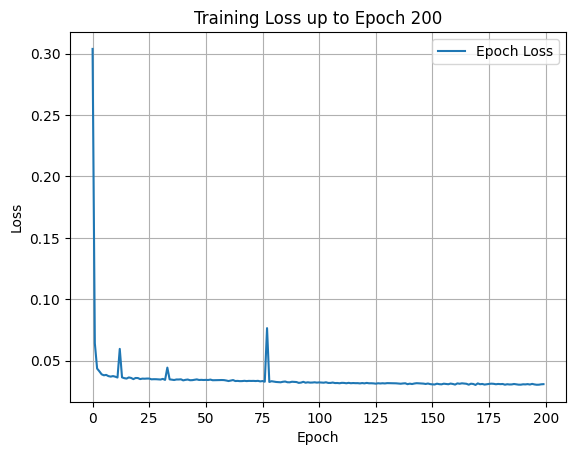

Processing epoch:   0%|          | 0/200 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

/app/design_analysis_server/tools/experimental/lib/design_data/notebook_cluster.runfiles/pypi_torch/site-packages/torch/nn/modules/conv.py:456: UserWarning: Attempt to open cnn_infer failed: handle=0 error: libcudnn_cnn_infer.so.8: cannot open shared object file: No such file or directory (Triggered internally at ../aten/src/ATen/native/cudnn/Conv_v8.cpp:78.)
  return F.conv2d(input, weight, bias, self.stride,


loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

loss::   0%|          | 0/196 [00:00<?, ?it/s]

In [12]:
train(data_loader=dataloader, n_epoch=200, device="cuda:1")

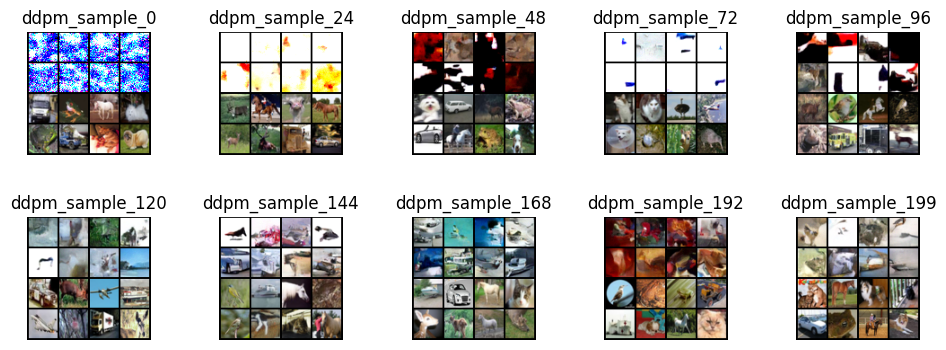

In [54]:
def plot_images_in_grid(image_folder: str, ncols=4, figsize=(12, 4), n_images=10):
    """
    Plot images from a folder in a grid with a specified number of columns.

    Args:
        image_folder: Directory containing the images.
        ncols: Number of columns in the grid.
        figsize: Figure size (width, height) in inches.
    """

    def custom_sort(item):
        prefix, suffix = item.rsplit("_", 1)
        return prefix, int(suffix.split(".")[0])

    image_files = [
        f
        for f in os.listdir(image_folder)
        if os.path.isfile(os.path.join(image_folder, f))
    ]
    image_files = sorted(image_files, key=custom_sort)

    step_size = max((len(image_files) - 2) // (n_images - 2), 1)
    image_files = (
        [image_files[0]] + image_files[step_size:-1:step_size] + [image_files[-1]]
    )

    nrows = (len(image_files) + ncols - 1) // ncols

    fig, axes = plt.subplots(nrows, ncols, figsize=figsize)

    if nrows == 1:
        axes = axes.reshape(1, -1)
    elif ncols == 1:
        axes = axes.reshape(-1, 1)

    for i, ax in enumerate(axes.flat):
        if i < len(image_files):
            image_path = os.path.join(image_folder, image_files[i])
            image = plt.imread(image_path)
            ax.imshow(image)
            ax.set_title(os.path.splitext(image_files[i])[0])
        ax.axis("off")

    plt.subplots_adjust(wspace=0.2, hspace=0.5)
    plt.show()


plot_images_in_grid("./images", ncols=5)

## Sampling 

In [13]:
device = "cuda:0"

In [75]:
state_dict = torch.load("./ddpm_weights.pth", map_location=device)

eps_model = NaiveUnet(3, 3, n_feat=256)
ddpm = DDPM(eps_model=eps_model, betas=(1e-4, 0.02), n_timesteps=1000)
ddpm.load_state_dict(state_dict)

ddpm = ddpm.to(device)

ddpm.eval()
print("Loaded in model")

Loaded in model


In [67]:
from ddpm import ddpm_schedules

module = nn.Module()
betas = (1e-4, 0.02)
n_timesteps = 1000

# Cheating... Register buffers with the module instance
schedules = ddpm_schedules(betas[0], betas[1], n_timesteps)
for k, v in schedules.items():
    module.register_buffer(k, v)

In [132]:
@torch.no_grad()
def sample_ddpm(n_samples: int, size: tuple, save_rate=20) -> torch.Tensor:
    x_i = torch.randn(n_samples, *size).to(device)
    intermediate = []

    for i in tqdm(range(n_timesteps, 0, -1), desc="Sampling timestep"):
        z = torch.randn(n_samples, *size).to(device) if i > 1 else 0

        eps = eps_model(
            x_i, torch.tensor(i / n_timesteps).to(device).repeat(n_samples, 1)
        )

        x_i = (
            module.oneover_sqrta[i] * (x_i - eps * module.mab_over_sqrtmab[i])
            + module.sqrt_beta_t[i] * z
        )
        if i % save_rate == 0 or i == n_timesteps or i < 10:
            intermediate.append(x_i.detach().cpu().numpy())

    intermediate = np.stack(intermediate)
    return x_i, intermediate

In [133]:
samples, intermediate_ddpm = sample_ddpm(32, images[0].shape)

Sampling timestep:   0%|          | 0/1000 [00:00<?, ?it/s]

In [134]:
print(intermediate_ddpm.shape)

(59, 32, 3, 32, 32)


In [138]:
# Function for unity normalization of an image
def unity_normalize(image):
    # Calculate the maximum and minimum values across all channels
    xmax = image.max((0, 1))
    xmin = image.min((0, 1))

    # Apply unity normalization to the image
    return (image - xmin) / (xmax - xmin)


# Function to apply unity normalization to all timesteps of all samples in a numpy array
def normalize_all_timesteps(store, num_timesteps, num_samples):
    normalized_store = np.zeros_like(store)
    for t in range(num_timesteps):
        for s in range(num_samples):
            normalized_store[t, s] = unity_normalize(store[t, s])
    return normalized_store


# Function to apply unity normalization to all timesteps of all samples in a torch tensor
def torch_normalize_all_timesteps(x_all):
    # Convert torch tensor to numpy array
    x = x_all.cpu().numpy()

    # Calculate the maximum and minimum values across all channels and pixels
    xmax = x.max((2, 3))
    xmin = x.min((2, 3))

    # Expand dimensions for broadcasting
    xmax = np.expand_dims(xmax, (2, 3))
    xmin = np.expand_dims(xmin, (2, 3))

    # Apply unity normalization to the tensor and convert back to torch tensor
    normalized_store = torch.from_numpy((x - xmin) / (xmax - xmin))
    return normalized_store


# Function to create a plot or animation of generated samples
def create_sample_plot_animation(
    x_gen_store, num_samples, nrows, save_dir, filename, save=False
):
    ncols = num_samples // nrows

    # Change the axis format to (height, width, channels) for numpy image format
    x_gen_store_numpy = np.moveaxis(x_gen_store, 2, 4)

    # Apply unity normalization to put the images in the range [0, 1] for np.imshow
    normalized_x_gen_store = normalize_all_timesteps(
        x_gen_store_numpy, x_gen_store_numpy.shape[0], num_samples
    )

    # Create a figure and axes for the animation
    fig, axs = plt.subplots(
        nrows=nrows, ncols=ncols, sharex=True, sharey=True, figsize=(ncols, nrows)
    )
    title = fig.text(0.5, 0.95, "Timestep 0", ha="center", va="center", fontsize=16)

    # Function to animate the images evolving over time
    def animate_frame(i, store):
        print(f"Animating frame {i} of {store.shape[0]}", end="\r")
        title.set_text(f"Timestep {i}")
        plots = []
        for row in range(nrows):
            for col in range(ncols):
                axs[row, col].clear()
                axs[row, col].set_xticks([])
                axs[row, col].set_yticks([])
                plots.append(axs[row, col].imshow(store[i, (row * ncols) + col]))
        return plots

    # Create the animation
    animation = FuncAnimation(
        fig,
        animate_frame,
        fargs=[normalized_x_gen_store],
        interval=200,
        blit=False,
        repeat=True,
        frames=normalized_x_gen_store.shape[0],
    )
    plt.close()

    # Save the animation as a GIF if specified
    if save:
        animation.save(
            f"{save_dir}/{filename}.gif", dpi=100, writer=PillowWriter(fps=5)
        )
        print(f"Saved GIF at {save_dir}/{filename}.gif")

    return animation


animation_ddpm = create_sample_plot_animation(
    intermediate_ddpm, 32, 4, "./images", "animation", save=True
)
HTML(animation_ddpm.to_jshtml())

Saved GIF at ./images/animation.gif


Animation size has reached 21050512 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.
